In [1]:
import os

from diff_viz import msd
from diff_viz import diffusion_modes
from diff_viz import feature_distribution_plots
from diff_viz import data_loading
from diff_viz import diff_utils
import pandas as pd
from os import getcwd, chdir
from diff_predictor import data_process
from diff_viz import diff_utils
import matplotlib.pyplot as plt
import numpy as np
import diff_classifier
from diff_classifier.features import unmask_track
import altair as alt

from diff_viz.heatmaps import plot_heatmap, plot_scatterplot, plot_trajectories
from diff_viz.viscosity import viscosity_from_diffusion_coefficient

In [2]:
phuong_data_path = '/Users/nelsschimek/Documents/nancelab/Data/qd_bev_data/Compiled_trajectories'

In [3]:
healthy_files_cortex = os.listdir(phuong_data_path + '/Healthy_QD-BEV/cortex/')
ogd_files_cortex = os.listdir(phuong_data_path + '/OGD_QD-BEV/cortex')
print(len(healthy_files_cortex))
print(len(ogd_files_cortex))

10
12


In [4]:
healthy_files_striatum = os.listdir(phuong_data_path + '/Healthy_QD-BEV/striatum/')
ogd_files_striatum = os.listdir(phuong_data_path + '/OGD_QD-BEV/striatum')
print(len(healthy_files_striatum))
print(len(ogd_files_striatum))

22
28


In [5]:
msd_healthy_cortex = [file for file in healthy_files_cortex if 'msd_10' in file and 'feat' not in file]
msd_ogd_cortex = [file for file in ogd_files_cortex if 'msd_10' in file and 'feat' not in file]
print(len(msd_healthy_cortex))
print(len(msd_ogd_cortex))

msd_healthy_striatum = [file for file in healthy_files_striatum if 'msd_10' in file and 'feat' not in file]
msd_ogd_striatum = [file for file in ogd_files_striatum if 'msd_10' in file and 'feat' not in file]
print(len(msd_healthy_striatum))
print(len(msd_ogd_striatum))

5
6
11
14


In [6]:
msd_ogd_cortex

['edited_msd_100X_OGD_QD-BEV_Cortex_Slice2_Video3.csv',
 'edited_msd_100X_Cortex_OGD_QD-BEV_Slice1_Video2.csv',
 'edited_msd_100X_OGD_Cortex_Slice2_Video1.csv',
 'edited_msd_100X_Cortex_OGD_QD-BEV_Slice1_Video4.csv',
 'edited_msd_100X_OGD_Cortex_Slice2_Video2.csv',
 'edited_msd_100X_OGD_Cortex_Slice3_Video1.csv']

In [7]:
huge_msd_list = msd_healthy_cortex + msd_ogd_cortex + msd_healthy_striatum + msd_ogd_striatum

In [8]:
def get_mean_geo_data(msd_files, filepath=None):
    """takes in a list of msd files and returns the mean of the geometric means and geometric standard errors

    Args:
        msd_files (list of string): files to average

    Returns:
        numpy array: averaged values across multiple CSVs
    """
    geo_means = []
    geo_sems = []
    
    for file in msd_files:
        msd_data = pd.read_csv(filepath+file)
        geo_mean, geosem = msd.get_geo_data(msd_data)
        geo_means.append(geo_mean[1:])
        geo_sems.append(geosem)

    averaged_geo_means = np.mean(geo_means, axis=0)
    averaged_geo_sems = np.mean(geo_sems, axis=0)
    return averaged_geo_means, averaged_geo_sems

In [9]:
msd_data = pd.read_csv(phuong_data_path + '/Healthy_QD-BEV/cortex/' + msd_healthy_cortex[0])
msd_data

,Unnamed: 0,Frame,Track_ID,X,Y,MSDs,Gauss,Quality,SN_Ratio,Mean_Intensity
0,0,0.0,0.0,26.795028,582.847376,0.000000,0.000000,3.408173,0.568303,177.959276
1,1,1.0,0.0,26.092786,583.694696,12.547716,1.372783,3.526039,0.627273,178.791855
2,2,2.0,0.0,25.390543,584.542016,35.623592,1.244951,3.643906,0.686244,179.624434
3,3,3.0,0.0,27.467998,586.003743,57.230030,0.972274,3.109314,0.584951,177.506787
4,4,4.0,0.0,27.962531,585.051787,75.276392,0.779037,3.324814,0.627363,178.855204
...,...,...,...,...,...,...,...,...,...,...
3765,9,9.0,65.0,742.737548,437.851247,44.863499,0.583472,1.117599,0.217867,168.226244
3766,10,10.0,65.0,741.061105,437.683207,49.166985,0.538534,1.106903,0.236437,168.371041
3767,11,11.0,65.0,739.384662,437.515166,50.897476,0.404778,1.096207,0.255008,168.515837
3768,12,12.0,65.0,737.708219,437.347126,40.596973,0.339035,1.085510,0.273578,168.660633


In [10]:
list_msd_healthy_cortex = []
list_msd_ogd_cortex = []
list_msd_healthy_striatum = []
list_msd_ogd_striatum = []

for file in msd_healthy_cortex:
    msd_data = pd.read_csv(phuong_data_path + '/Healthy_QD-BEV/cortex/' + file)
    geo_mean, geosem = msd.get_geo_data(msd_data)
    list_msd_healthy_cortex.append(np.array(geo_mean))

for file in msd_ogd_cortex:
    msd_data = pd.read_csv(phuong_data_path + '/OGD_QD-BEV/cortex/' + file)
    geo_mean, geosem = msd.get_geo_data(msd_data)
    list_msd_ogd_cortex.append(geo_mean)

for file in msd_healthy_striatum:
    msd_data = pd.read_csv(phuong_data_path + '/Healthy_QD-BEV/striatum/' + file)
    geo_mean, geosem = msd.get_geo_data(msd_data)
    list_msd_healthy_striatum.append(geo_mean)

for file in msd_ogd_striatum:
    msd_data = pd.read_csv(phuong_data_path + '/OGD_QD-BEV/striatum/' + file)
    geo_mean, geosem = msd.get_geo_data(msd_data)
    list_msd_ogd_striatum.append(geo_mean)

In [11]:
msd_data

,Unnamed: 0,Frame,Track_ID,X,Y,MSDs,Gauss,Quality,SN_Ratio,Mean_Intensity
0,0,0.0,0.0,378.361,898.961,0.000000,0.000000,1.746,0.366,167.824
1,1,1.0,0.0,378.219,897.899,35.893444,0.604742,1.019,0.268,167.425
2,2,2.0,0.0,369.696,894.923,87.272607,0.475688,1.504,0.447,168.217
3,3,3.0,0.0,365.949,895.170,128.808970,0.528131,0.943,0.311,167.217
4,4,4.0,0.0,371.410,888.988,141.008535,0.546360,0.948,0.300,166.828
...,...,...,...,...,...,...,...,...,...,...
290,90,90.0,18.0,648.633,183.972,135.401883,0.355000,0.811,0.167,165.113
291,91,91.0,18.0,646.672,178.353,88.220376,0.547613,1.056,0.267,167.525
292,92,92.0,18.0,642.190,180.694,48.025329,0.564543,0.943,0.320,166.824
293,93,93.0,18.0,643.404,176.287,9.484785,0.441896,1.247,0.327,167.326


In [12]:
for file in list_msd_healthy_cortex:
    print(len(file))

651
651
651
651
651


Text(0.5, 1.0, 'Healthy Cortex')

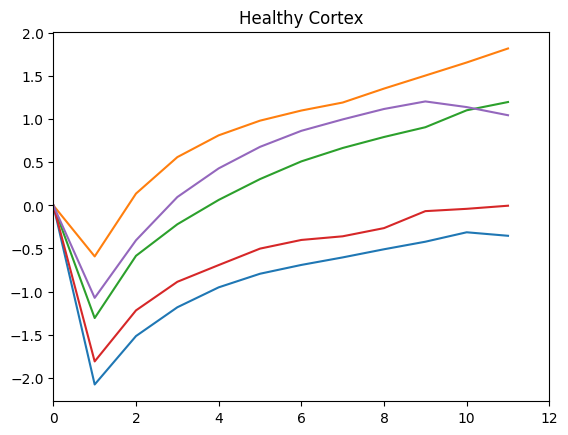

In [45]:
for file in list_msd_healthy_cortex:
    file[0] = 0
    plt.plot(file[0:12])
plt.xlim(0, 12)
plt.title('Healthy Cortex')

Text(0.5, 1.0, 'OGD Cortex')

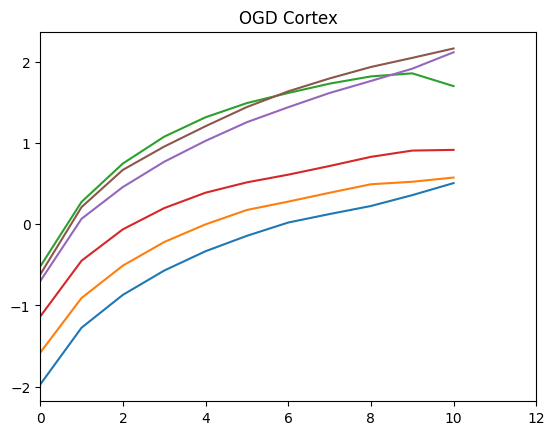

In [46]:
for file in list_msd_ogd_cortex:
    plt.plot(file[1:12])
plt.xlim(0, 12)
plt.title('OGD Cortex')

Text(0.5, 1.0, 'Healthy Striatum')

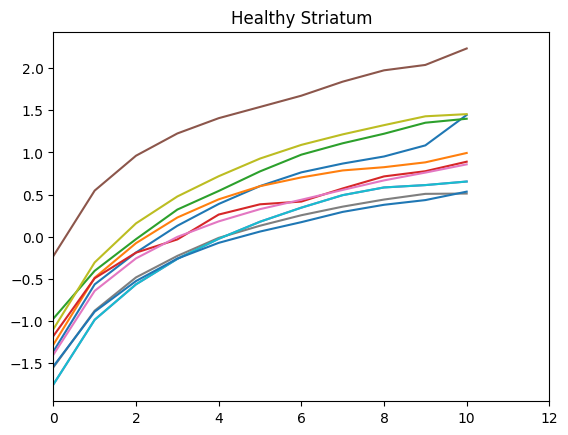

In [47]:
for file in list_msd_healthy_striatum:
    plt.plot(file[1:12])
plt.xlim(0, 12)
plt.title('Healthy Striatum')

Text(0.5, 1.0, 'OGD Striatum')

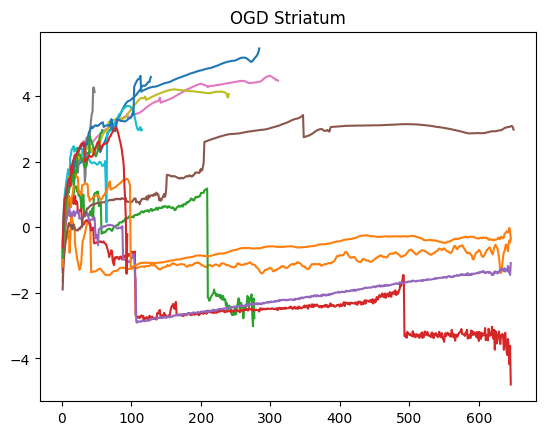

In [48]:
for file in list_msd_ogd_striatum:
    plt.plot(file)
plt.title('OGD Striatum')

In [13]:
healthy_cortex_geo_means, healthy_cortex_geo_sems = get_mean_geo_data(msd_healthy_cortex, filepath=phuong_data_path + '/Healthy_QD-BEV/cortex/')

In [15]:
ogd_cortex_geo_means, ogd_cortex_geo_sems = get_mean_geo_data(msd_ogd_cortex, filepath=phuong_data_path + '/OGD_QD-BEV/cortex/')

In [16]:
healthy_striatum_geo_means, healthy_striatum_geo_sems = get_mean_geo_data(msd_healthy_striatum, filepath=phuong_data_path + '/Healthy_QD-BEV/striatum/')

In [17]:
ogd_striatum_geo_means, ogd_striatum_geo_sems = get_mean_geo_data(msd_ogd_striatum, filepath=phuong_data_path + '/OGD_QD-BEV/striatum/')

In [18]:
cortex_geo_mean_df = pd.DataFrame({'healthy_cortex': healthy_cortex_geo_means, 'ogd_cortex': ogd_cortex_geo_means})
cortex_geo_sem_df = pd.DataFrame({'healthy_cortex': healthy_cortex_geo_sems, 'ogd_cortex': ogd_cortex_geo_sems})
striatum_geo_mean_df = pd.DataFrame({'healthy_striatum': healthy_striatum_geo_means, 'ogd_striatum': ogd_striatum_geo_means})
striatum_geo_sem_df = pd.DataFrame({'healthy_striatum': healthy_striatum_geo_sems, 'ogd_striatum': ogd_striatum_geo_sems})

In [19]:
full_geomean_df = pd.concat([cortex_geo_mean_df, striatum_geo_mean_df], axis=1)
print(len(full_geomean_df))
full_geosem_df = pd.concat([cortex_geo_sem_df, striatum_geo_sem_df], axis=1)
print(len(full_geosem_df))

650
651


In [20]:
tau = cortex_geo_mean_df.index.values/651

In [21]:
np.exp(full_geomean_df['ogd_cortex'])

0      0.336558
1      0.707061
2      1.074524
3      1.445566
4      1.823160
         ...   
645         NaN
646         NaN
647         NaN
648         NaN
649         NaN
Name: ogd_cortex, Length: 650, dtype: float64

In [22]:
def plot_msd_vs_tau(full_geomean_df, tau, column_names, data_range=(0,20), scale_func=None):
    """
    Plot data with flexible scaling and variable data range.

    Parameters:
    - full_geomean_df: DataFrame containing the data.
    - tau: The x-axis values for the plot.
    - column_names: List of strings, names of the columns in full_geomean_df to plot.
    - num_points: Integer, how many of the first data points to plot. Defaults to 20.
    - scale_func: Function to scale the data. Defaults to np.exp.
    """

    fig = plt.figure()

    if scale_func is not None:
        for column_name in column_names:
            plt.plot(tau[data_range[0]:data_range[1]], 
                     scale_func(full_geomean_df[column_name][data_range[0]:data_range[1]]), label=column_name)
    else:
        for column_name in column_names:
            plt.plot(tau[data_range[0]:data_range[1]], 
                     full_geomean_df[column_name][data_range[0]:data_range[1]], label=column_name)
    
    plt.legend()
    #plt.show()
    return fig

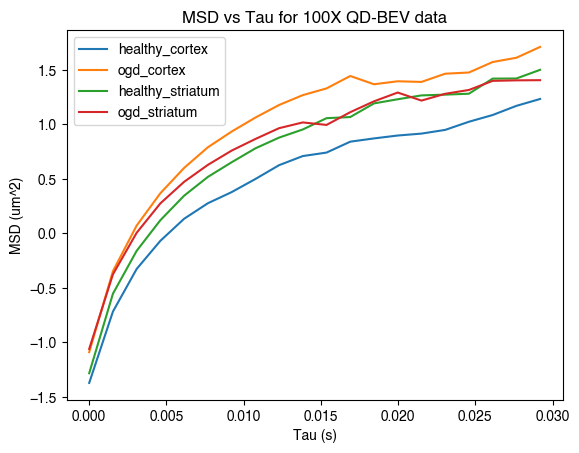

In [34]:
fig = plot_msd_vs_tau(full_geomean_df, tau, ['healthy_cortex', 'ogd_cortex', 'healthy_striatum', 'ogd_striatum'], scale_func=None, data_range=(0,20))
plt.title('MSD vs Tau for 100X QD-BEV data')
plt.ylabel('MSD (um^2)')
plt.xlabel('Tau (s)')
plt.show()

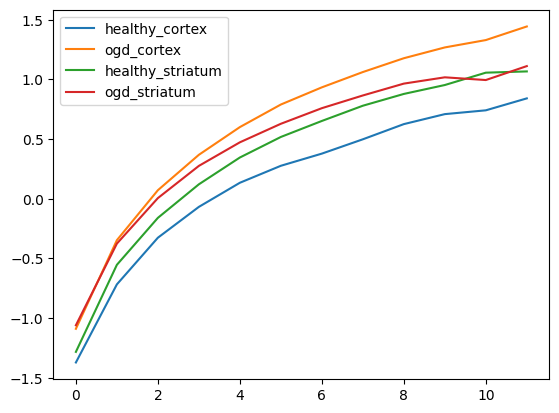

In [24]:
plt.plot(full_geomean_df['healthy_cortex'][0:12], label='healthy_cortex')
plt.plot(full_geomean_df['ogd_cortex'][0:12], label='ogd_cortex')
plt.plot(full_geomean_df['healthy_striatum'][0:12], label='healthy_striatum')
plt.plot(full_geomean_df['ogd_striatum'][0:12], label='ogd_striatum')
plt.legend()


In [25]:
def testing_msd_viz(doses,geomean_df,geosem_df,fps):
    """
    Visualize MSD data from diffusivity experiments.
    
    Parameters
    ----------
        doses (list):
            List of doses used in the experiment.
        geomean_df (pandas.DataFrame):
            DataFrame containing the mean-squared displacement data.
        geosem_df (pandas.DataFrame):
            DataFrame containing the standard error of the mean-squared displacement data.
        fps (int):
            Frames per second of the experiment.

    Returns
    -------
        fig (matplotlib.figure.Figure):
            Figure containing the MSD data.

    """
    count=0
    msd_dose_list=diff_utils.get_df_dose_list(doses,geomean_df)
    sem_dose_list=diff_utils.get_df_dose_list(doses,geosem_df)
    
    if len(doses)==1:
        tau=geomean_df.index.values/651
        fig,ax=plt.subplots(figsize=(6,6))
        plt.rcParams.update({'font.family':'helvetica'})
        handles=list(geomean_df.columns)
        #print('tau',tau)
        print('geomean_df[handle]', geomean_df[handles[0]]/2)#+geosem_df[handles[0]]/2)
        #print('geosem_df[handle]',geosem_df[handle])
    
        for handle in handles:
            ax.loglog(tau,geomean_df[handle])
            ax.set_xlabel('Lag time (s)',fontsize=16)
            ax.set_ylabel('Mean-squared displacement (μ$m^2$)',fontsize=16)
            
            
            ax.fill_between(tau,geomean_df[handle]+geosem_df[handle]/2,geomean_df[handle]-geosem_df[handle]/2,cmap='ocean',alpha=0.2)
            #ax.legend(handles,loc='best')
            #ax.set_xlim([0.008, 0.2])
            #ax.set_ylim([0.008,1])
            #ax.set_title(f'\n{doses[c]}\n', fontsize=16)
         
    else:                
        tau=geomean_df.index.values/651
        #fig,axes=plt.subplots(nrows=1,ncols=len(doses),figsize=(len(doses)*6,6))
        fig,axes=plt.subplots(nrows=1,ncols=1,figsize=(len(doses)*6,6))
        plt.rcParams.update({'font.family':'helvetica'})
        count=0
        
        for c in np.arange(0,len(doses)):
            while count<=c:
                sem_handles = list(sem_dose_list[c].columns)
                msd_handles = list(msd_dose_list[c].columns)
                print(msd_dose_list[count].values.flatten().shape)
                #print(msd_dose_list[count]+sem_dose_list[count]/2)
                axes.loglog(tau,msd_dose_list[count], label=doses[c])
                axes.fill_between(tau,
                                    (msd_dose_list[count]+sem_dose_list[count]/2).values.flatten(),
                                    (msd_dose_list[count]-sem_dose_list[count]/2).values.flatten(),
                                    cmap='ocean',
                                    alpha=0.2)
                axes.set_xlabel('\nLag time (s)',fontsize=16)               
                

                #axes[c].set_xlim([0.008, 1])
                #axes[c].set_ylim([0.008,1])
                axes.set_title(f'\n{doses[c]}\n', fontsize=16)
    
                if c == 0:
                    axes.set_ylabel('Mean-squared displacement (μ$m^2$)',fontsize=16)
    
                count+=1
                axes.legend(loc='best')
    return fig

(650,)


ValueError: operands could not be broadcast together with shapes (650,) (651,) 

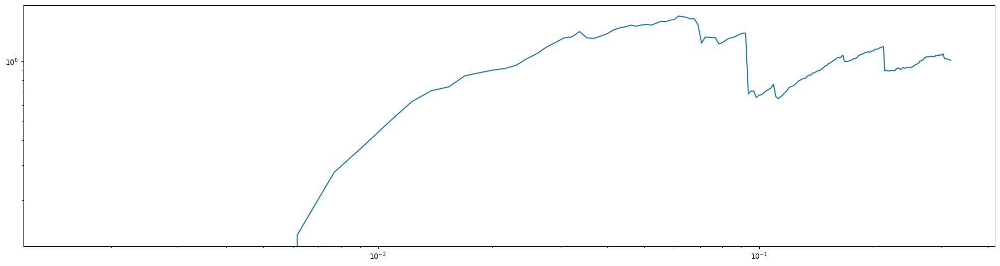

In [26]:
fig = testing_msd_viz(['healthy_cortex', 'ogd_cortex', 'healthy_striatum', 'ogd_striatum'], geomean_df=full_geomean_df, geosem_df=full_geosem_df, fps=100)

In [27]:
def msd_viz(doses,geomean_df,df_dose_list):
    count = 0
    
    # if len(doses) == 1:
    #     tau = geomean_df.index.values / 651
    #     fig, ax = plt.subplots(figsize=(5,5))
    #     plt.rcParams.update({'font.family':'helvetica'})
    #     handles = list(geomean_df.columns)
    #     #labels = [handle.split(stimulus+'_')[1] for handle in handles] # this wont work
    
    #     for handle in handles:
    #         ax.loglog(tau [0:70],geomean_df[handle][0:70]) #Can take out the 0:70 part to get the whole graph
    #         ax.set_xlabel('Lag time (s)',fontsize=16)
    #         ax.set_ylabel('Mean-squared displacement (μ$m^2$)',fontsize=16)
    #         #ax.legend(labels,loc='upper left') #this wont either
    #         ax.set_xlim([0.002, 0.05])
    #         ax.set_ylim([0.0009,1.3])
    #         #axes[c].set_title(f'\n{doses[c]}\n', fontsize=16)
    #     ax.legend(handles)

         
   # else:                
    tau = geomean_df.index.values/651
    fig, axes = plt.subplots(nrows=1, ncols=len(doses),figsize=(12,6))
    plt.rcParams.update({'font.family':'helvetica'})
    count=0
    
    for c in np.arange(0,len(doses)):
        handles = list(df_dose_list[c].columns)
        times = []
        handles = list(df_dose_list[c].columns)
        #labels = [handle.split(stimulus+'_')[1] for handle in handles]
        axes[c].loglog(tau[0:70],df_dose_list[count][0:70])
        axes[c].set_xlabel('\nLag time (s)',fontsize=16)
        #axes[c].legend(labels,loc='best')
        axes[c].set_xlim([0.002, 0.02])
        axes[c].set_ylim([0.0009,10])
        axes[c].set_title(f'\n{doses[c]}\n', fontsize=16)

        if c == 0:
            axes[c].set_ylabel('Mean-squared displacement (μ$m^2$)',fontsize=16)

        count+=1
    return

In [28]:
def get_df_dose_list(doses,geo_df):
    df_dose_list = []
    
    for dose in doses:
        dose_df = pd.DataFrame()
        dose_cols = [col for col in geo_df.columns if dose in col]
        dose_df = geo_df.filter(dose_cols, axis=1)
        df_dose_list.append(dose_df)
        
    return df_dose_list

In [29]:
df_dose_list = get_df_dose_list(['healthy_cortex', 'ogd_cortex', 'healthy_striatum', 'ogd_striatum'], full_geomean_df)

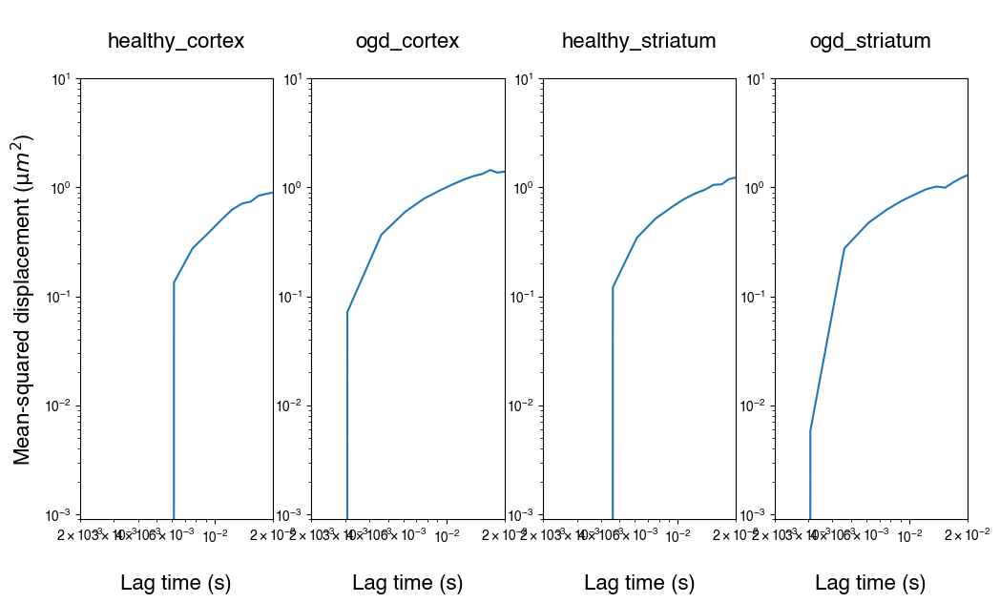

In [30]:
msd_viz(doses=['healthy_cortex', 'ogd_cortex', 'healthy_striatum', 'ogd_striatum'], geomean_df=full_geomean_df, df_dose_list=df_dose_list)

## Lets plot MSD plots for each video!

#### First, healthy cortex

In [31]:
for file in msd_healthy_cortex:
    fig = msd.plot_individual_msds(df=pd.read_csv(phuong_data_path + '/Healthy_QD-BEV/cortex/' + file), x_range=1, y_range=20, title='Healthy Cortex: '+ file[:-4])
    fig.savefig('/Users/nelsschimek/Documents/nancelab/diff_viz/output/' + 'Healthy_Cortex_' + file[:-4] + '_msd_plot.png')

ValueError: could not broadcast input array from shape (47,) into shape (651,)

<Figure size 1000x1000 with 0 Axes>

In [ ]:
for file in msd_ogd_cortex:
    fig = msd.plot_individual_msds(df=pd.read_csv(phuong_data_path + '/OGD_QD-BEV/cortex/' + file), x_range=1, y_range=20, title='OGD Cortex: '+ file[:-4])
    fig.savefig('/Users/nelsschimek/Documents/nancelab/diff_viz/output/' + 'OGD_Cortex_' + file[:-4] + '_msd_plot.png')

In [ ]:
for file in msd_healthy_striatum:
    fig = msd.plot_individual_msds(df=pd.read_csv(phuong_data_path + '/Healthy_QD-BEV/striatum/' + file), x_range=1, y_range=20, title='Healthy Striatum: '+ file[:-4])
    fig.savefig('/Users/nelsschimek/Documents/nancelab/diff_viz/output/' + 'Healthy_Striatum_' + file[:-4] + '_msd_plot.png')

In [ ]:
for file in msd_ogd_striatum:
    fig = msd.plot_individual_msds(df=pd.read_csv(phuong_data_path + '/OGD_QD-BEV/striatum/' + file), x_range=1, y_range=20, title='OGD Striatum: '+ file[:-4])
    fig.savefig('/Users/nelsschimek/Documents/nancelab/diff_viz/output/' + 'OGD_Striatum_' + file[:-4] + '_msd_plot.png')

# Features analysis

In [6]:
features_healthy_cortex = [file for file in healthy_files_cortex if 'features' in file]
features_ogd_cortex = [file for file in ogd_files_cortex if 'features' in file]
print(len(features_healthy_cortex))
print(len(features_ogd_cortex))

features_healthy_striatum = [file for file in healthy_files_striatum if 'features' in file]
features_ogd_striatum = [file for file in ogd_files_striatum if 'features' in file]
print(len(features_healthy_striatum))
print(len(features_ogd_striatum))

5
6
11
14


In [7]:
list_features_healthy_cortex = []
list_features_ogd_cortex = []
list_features_healthy_striatum = []
list_features_ogd_striatum = []

for file in features_healthy_cortex:
    feature_data = pd.read_csv(phuong_data_path + '/Healthy_QD-BEV/cortex/' + file)
    list_features_healthy_cortex.append(feature_data)

   

for file in features_ogd_cortex:
    feature_data = pd.read_csv(phuong_data_path + '/OGD_QD-BEV/cortex/' + file)
    list_features_ogd_cortex.append(feature_data)
  

for file in features_healthy_striatum:
    feature_data = pd.read_csv(phuong_data_path + '/Healthy_QD-BEV/striatum/' + file)
    list_features_healthy_striatum.append(feature_data)
  

for file in features_ogd_striatum:
    feature_data = pd.read_csv(phuong_data_path + '/OGD_QD-BEV/striatum/' + file)
    list_features_ogd_striatum.append(feature_data)


In [8]:
all_features_healthy_cortex = pd.concat(list_features_healthy_cortex)
all_features_healthy_cortex['target'] = 'healthy_cortex'
all_features_ogd_cortex = pd.concat(list_features_ogd_cortex)
all_features_ogd_cortex['target'] = 'ogd_cortex'
all_features_healthy_striatum = pd.concat(list_features_healthy_striatum)
all_features_healthy_striatum['target'] = 'healthy_striatum'
all_features_ogd_striatum = pd.concat(list_features_ogd_striatum)
all_features_ogd_striatum['target'] = 'ogd_striatum'

all_features = pd.concat([all_features_healthy_cortex, all_features_ogd_cortex, all_features_healthy_striatum, all_features_ogd_striatum])
all_features.shape

(858, 69)

In [9]:
feature_list = ['alpha', # Fitted anomalous diffusion alpha exponenet
    'D_fit', # Fitted anomalous diffusion coefficient
    'kurtosis', # Kurtosis of track
    'asymmetry1', # Asymmetry of trajecory (0 for circular symmetric, 1 for linear)
    'asymmetry2', # Ratio of the smaller to larger principal radius of gyration
    'asymmetry3', # An asymmetric feature that accnts for non-cylindrically symmetric pt distributions
    'AR', # Aspect ratio of long and short side of trajectory's minimum bounding rectangle
    'elongation', # Est. of amount of extension of trajectory from centroid
    'boundedness', # How much a particle with Deff is restricted by a circular confinement of radius r
    'fractal_dim', # Measure of how complicated a self similar figure is
    'trappedness', # Probability that a particle with Deff is trapped in a region
    'efficiency', # Ratio of squared net displacement to the sum of squared step lengths
    'straightness', # Ratio of net displacement to the sum of squared step lengths
    'MSD_ratio', # MSD ratio of the track
    'Deff1', # Effective diffusion coefficient at 0.33 s
    'Deff2', # Effective diffusion coefficient at 3.3 s
]

In [10]:
all_features_cleaned = all_features[~all_features[list(set(feature_list)-set(['Deff2', 'Mean Deff2']))].isin([np.inf, np.nan, -np.inf]).any(axis=1)]
all_features_cleaned.shape

(834, 69)

In [11]:
hist1 = alt.Chart(all_features_cleaned[all_features_cleaned['target'] == 'healthy_cortex']).mark_bar().encode(
    alt.X('frames', bin=True, title='Frames'),
    alt.Y('count()', title='Count'),
)

hist2 = alt.Chart(all_features_cleaned[all_features_cleaned['target'] == 'ogd_cortex']).mark_bar().encode(
    alt.X('frames', bin=True, title='Frames'),
    alt.Y('count()', title='Count'),
)

hist3 = alt.Chart(all_features_cleaned[all_features_cleaned['target'] == 'healthy_striatum']).mark_bar().encode(
    alt.X('frames', bin=True, title='Frames'),
    alt.Y('count()', title='Count'),
)

hist4 = alt.Chart(all_features_cleaned[all_features_cleaned['target'] == 'ogd_striatum']).mark_bar().encode(
    alt.X('frames', bin=True, title='Frames'),
    alt.Y('count()', title='Count'),
)

layered_hist = alt.layer(hist1, hist2, hist3, hist4).resolve_scale(y='independent')

layered_hist.display()

alt.LayerChart(...)

In [34]:
alt.data_transformers.disable_max_rows()


alt.Chart(all_features_cleaned).mark_bar(opacity=0.5, interpolate='step').encode(
    alt.X('frames:Q', bin=alt.Bin(maxbins=100), title='Frames'),
    alt.Y('count()', title='Count'),
    color='target:N'
)

alt.Chart(...)

In [12]:
all_features_cleaned[feature_list].max()

alpha           7.471160e+00
D_fit           1.418753e+02
kurtosis        9.930353e+00
asymmetry1      1.000000e+00
asymmetry2      9.340318e-01
asymmetry3      6.931472e-01
AR              1.633124e+16
elongation      1.000000e+00
boundedness     4.925299e-01
fractal_dim     4.431015e+00
trappedness    -8.446987e-02
efficiency      9.754387e+00
straightness    9.815365e-01
MSD_ratio       1.576281e+01
Deff1           7.170503e+01
Deff2           1.237001e+01
dtype: float64

In [63]:
all_features_cleaned

,Unnamed: 0,Track_ID,alpha,D_fit,kurtosis,asymmetry1,asymmetry2,asymmetry3,AR,elongation,...,Std Quality,Mean Mean_Intensity,Std Mean_Intensity,Mean SN_Ratio,Std SN_Ratio,Mean Deff1,Std Deff1,Mean Deff2,Std Deff2,target
0,0,0.0,4.549814e-01,29.217447,1.890132,0.818971,0.223350,0.225046,1.862222,0.463007,...,0.168850,NaN,NaN,0.538547,0.084994,4.689294,1.270376,NaN,NaN,healthy_cortex
1,1,1.0,3.155671e-01,0.041801,3.067711,0.118014,0.699009,0.015817,1.180418,0.152842,...,0.000000,NaN,NaN,0.828329,0.000000,0.017878,0.000000,0.001997,0.0,healthy_cortex
2,2,2.0,4.601547e-01,3.005217,2.700604,0.340579,0.512788,0.053255,1.386553,0.278787,...,0.000000,NaN,NaN,0.270739,0.000000,1.501413,0.000000,NaN,NaN,healthy_cortex
3,3,3.0,7.603225e-01,6.330069,2.277669,0.545542,0.387744,0.102391,1.222946,0.182302,...,0.168850,NaN,NaN,0.538547,0.084994,4.689294,1.270376,NaN,NaN,healthy_cortex
4,4,4.0,6.061336e-01,13.798713,3.530101,0.935347,0.129259,0.352792,2.354904,0.575354,...,0.168850,NaN,NaN,0.538547,0.084994,4.689294,1.270376,NaN,NaN,healthy_cortex
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4,4,9.0,2.070893e-01,3.773091,2.467316,0.999716,0.008424,0.660549,10.000000,0.900000,...,0.011827,NaN,NaN,0.426036,0.200131,2.090571,1.079967,NaN,NaN,ogd_striatum
5,5,10.0,8.559481e-01,1.495336,4.916976,0.430229,0.455839,0.072415,1.496618,0.331827,...,0.013033,NaN,NaN,0.239375,0.000958,0.830040,0.120337,NaN,NaN,ogd_striatum
6,6,11.0,1.579946e-01,8.980982,2.578422,0.980282,0.070560,0.472999,3.702469,0.729910,...,0.000000,NaN,NaN,0.271700,0.000000,0.854156,0.000000,NaN,NaN,ogd_striatum
7,7,12.0,6.173838e-08,4.030185,3.086686,0.746486,0.270120,0.180460,1.241588,0.194580,...,0.013033,NaN,NaN,0.239375,0.000958,0.830040,0.120337,NaN,NaN,ogd_striatum


In [64]:
import altair as alt
import pandas as pd
import numpy as np

def plot_diffusion_modes_altair(df, label_column):
    # Transform the data frame to have a 'mode' column and a 'percentage' column
    transformed_df = []
    labels = df[label_column].unique()
    labels.sort()
    
    for label in labels:
        ecm = df[df[label_column] == label]
        total_count = len(ecm)
        
        superdiffusive_count = len(ecm[ecm['alpha'] > 1.1])
        brownian_count = len(ecm[(ecm['alpha'] <= 1.1) & (ecm['alpha'] >= 0.9)])
        subdiffusive_count = len(ecm[ecm['alpha'] < 0.9])
        
        # Note: The order here determines the stack order. Reverse it to match your requirements.
        transformed_df.append([label, 'Superdiffusive', superdiffusive_count / total_count])
        transformed_df.append([label, 'Brownian', brownian_count / total_count])
        transformed_df.append([label, 'Subdiffusive', subdiffusive_count / total_count])
    
    transformed_df = pd.DataFrame(transformed_df, columns=[label_column, 'Mode', 'Percentage'])
    
    # Ensure the order of modes matches desired stack order by sorting
    mode_order = ['Subdiffusive', 'Brownian', 'Superdiffusive']
    transformed_df['Mode'] = pd.Categorical(transformed_df['Mode'], categories=mode_order, ordered=True)
    transformed_df = transformed_df.sort_values('Mode')
    
    # Create the Altair chart for stacked bar chart with specified order
    chart = alt.Chart(transformed_df).mark_bar().encode(
        x=alt.X(f'{label_column}:N', title=label_column),
        y=alt.Y('sum(Percentage):Q', title='Percentage', axis=alt.Axis(format='%')),
        color=alt.Color('Mode:N', scale=alt.Scale(domain=mode_order,
                                                  range=['#b7a57a', '#999999', '#4b2e83']),
                        sort=mode_order),
        #order=alt.Order('Mode', sort='descending')  # This controls the layering of bars in the stack
    ).properties(
        width=600,
        height=400
    )
    
    return chart


In [65]:
fig = plot_diffusion_modes_altair(all_features_cleaned, 'target')
fig

alt.Chart(...)

Text(0.5, 1.0, 'Percentage of Diffusion Modes per Condition, 100x')

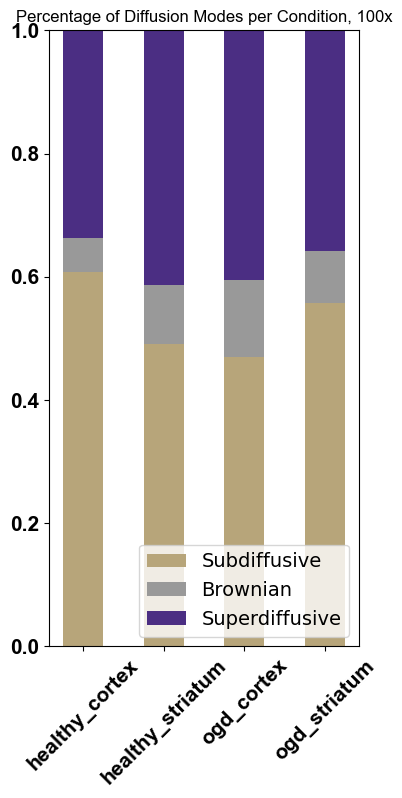

In [66]:
fig = diffusion_modes.plot_diffusion_modes(all_features_cleaned, 'target')
plt.xticks(rotation=45)
plt.title('Percentage of Diffusion Modes per Condition, 100x')
#plt.title('100x')

alpha
D_fit
kurtosis
asymmetry1
asymmetry2
asymmetry3
AR
elongation
boundedness
fractal_dim
trappedness
efficiency
straightness
MSD_ratio
Deff1
Deff2


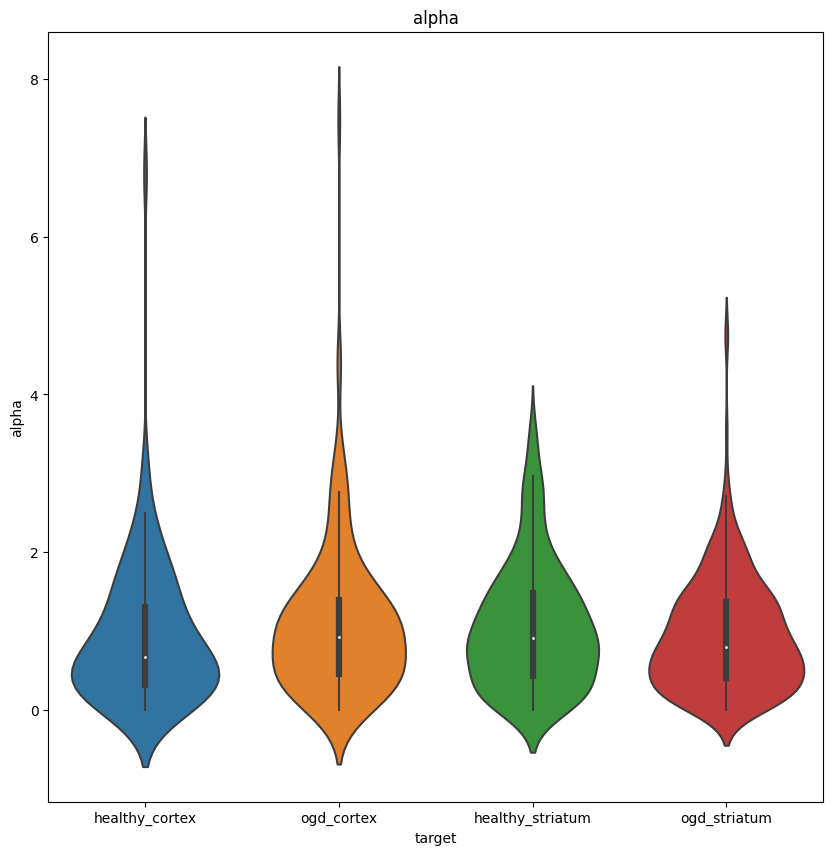

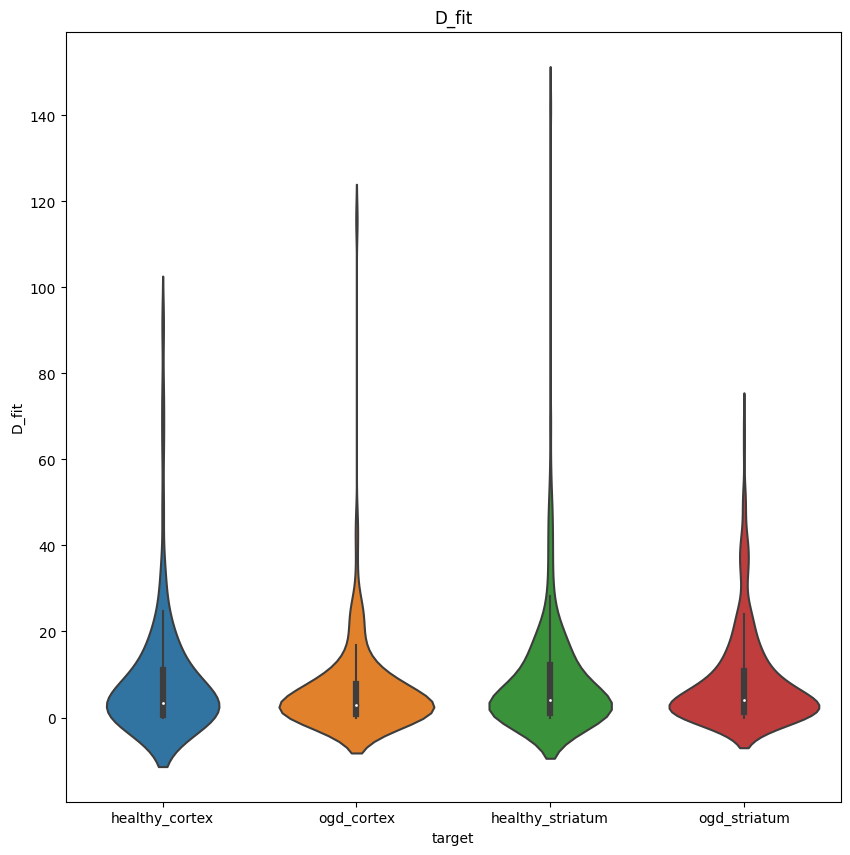

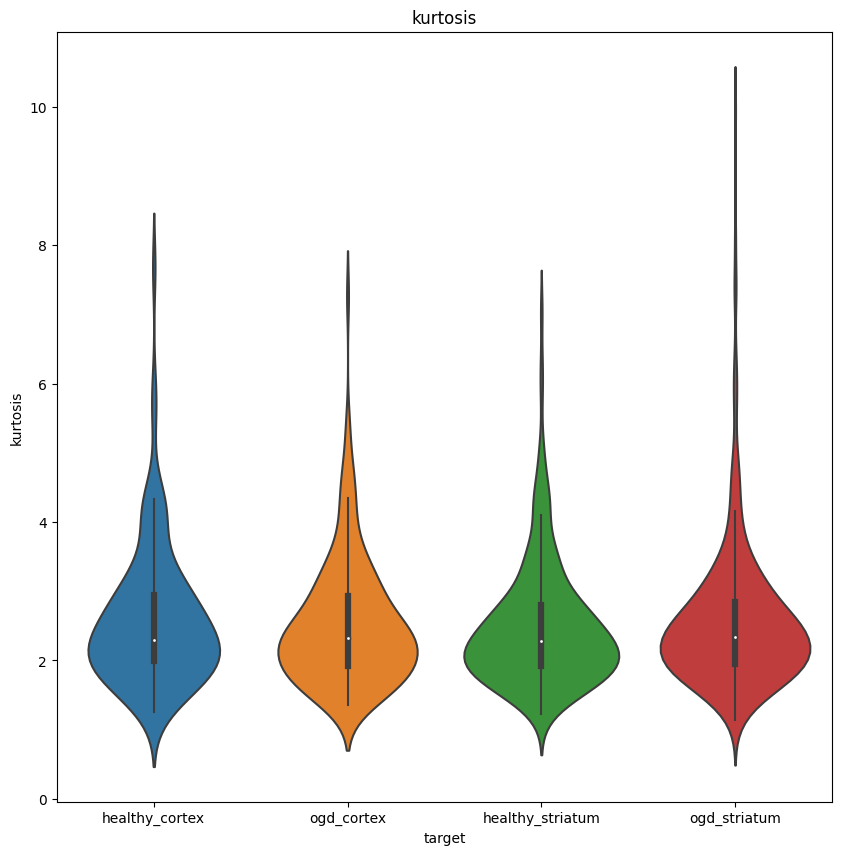

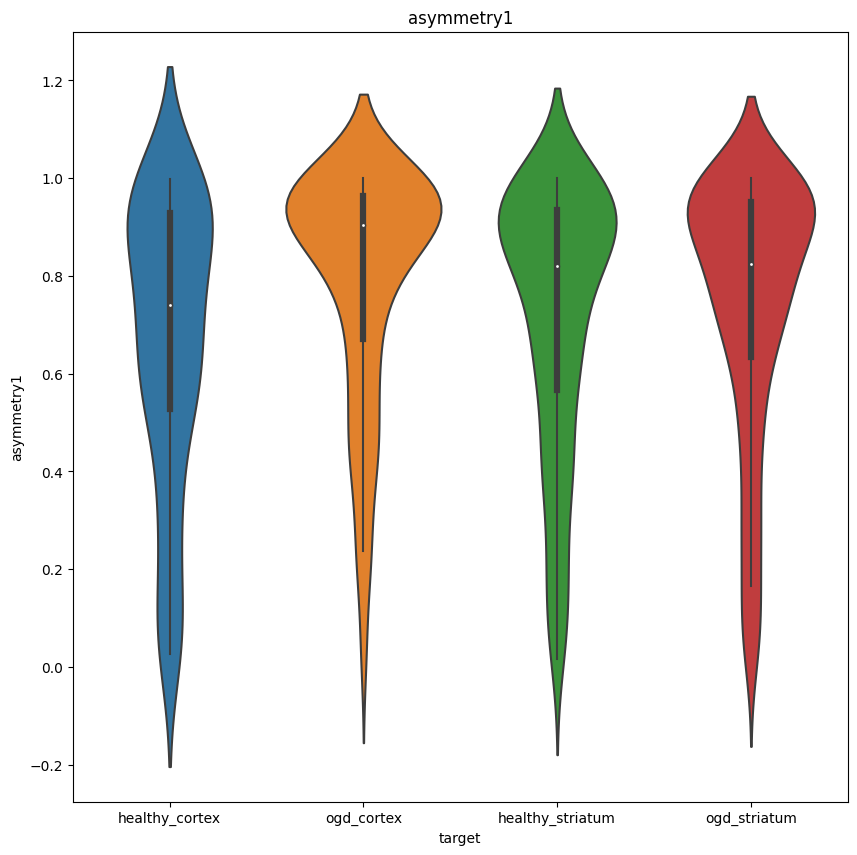

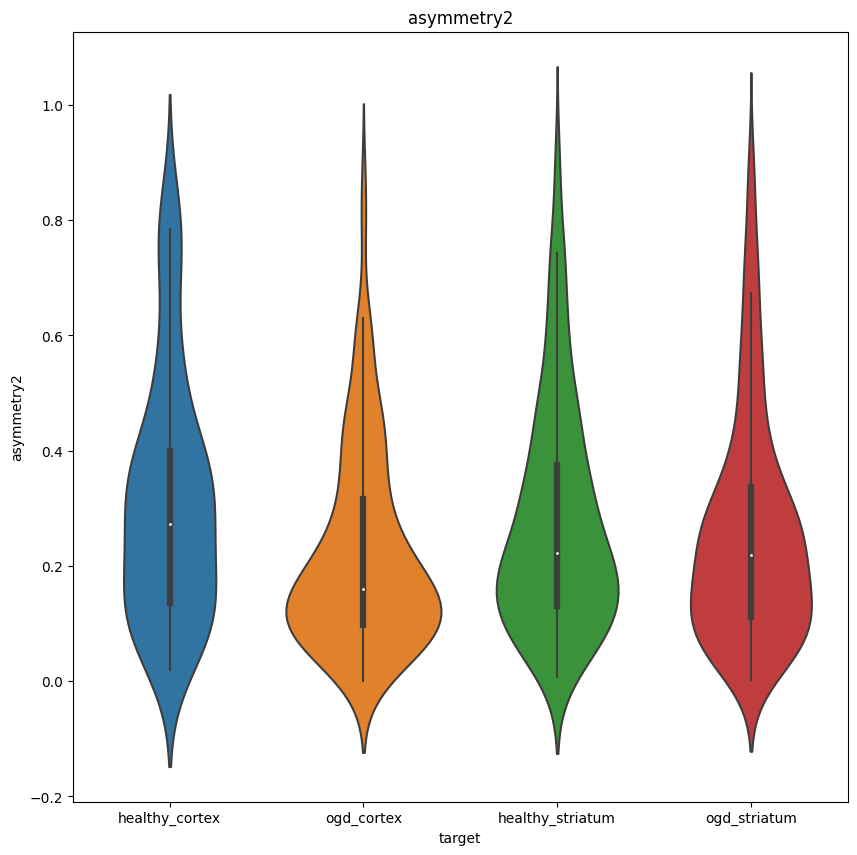

...

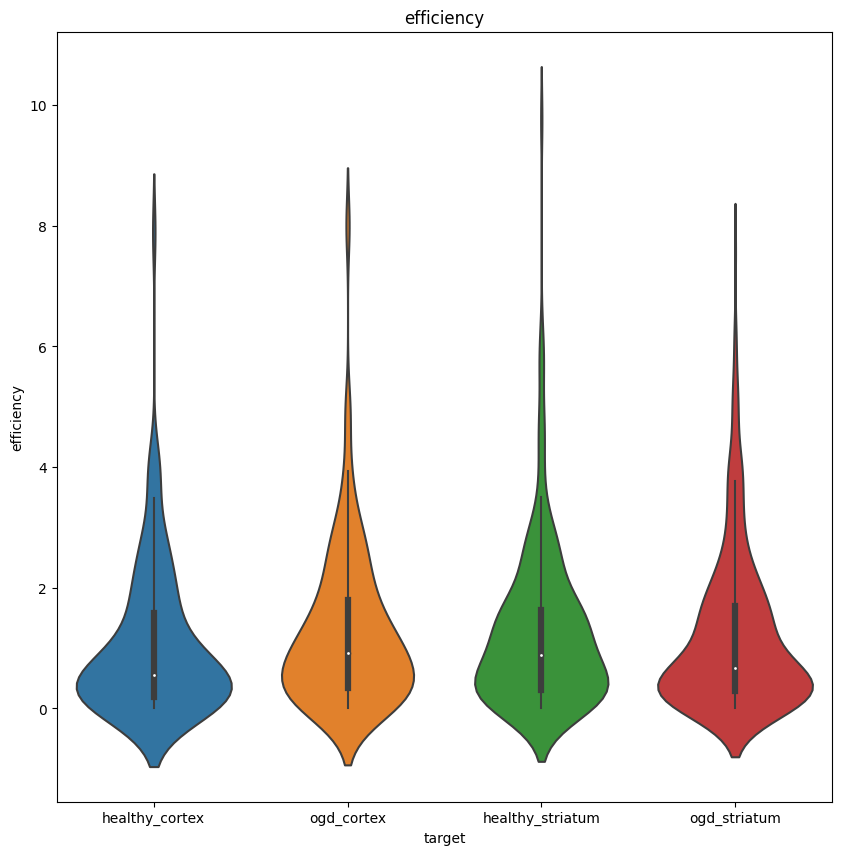

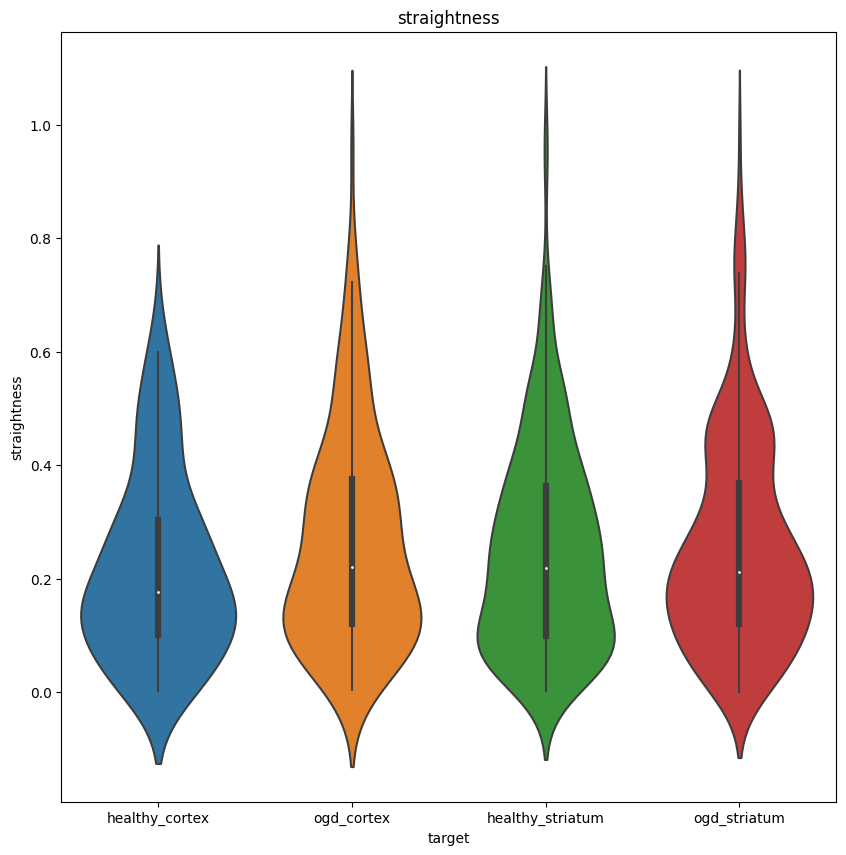

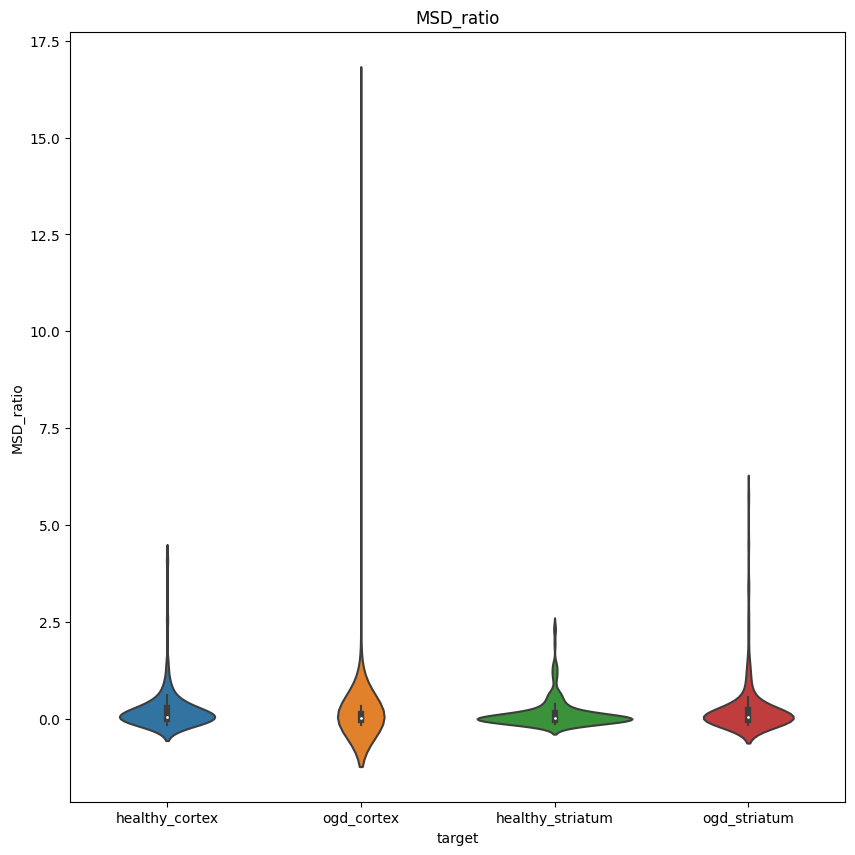

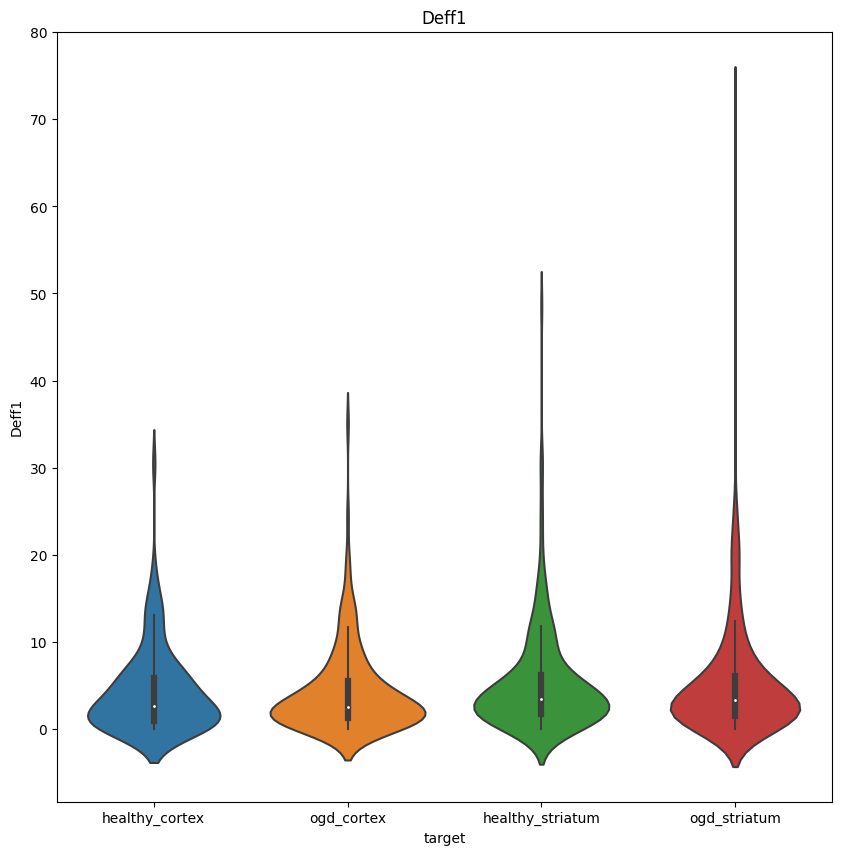

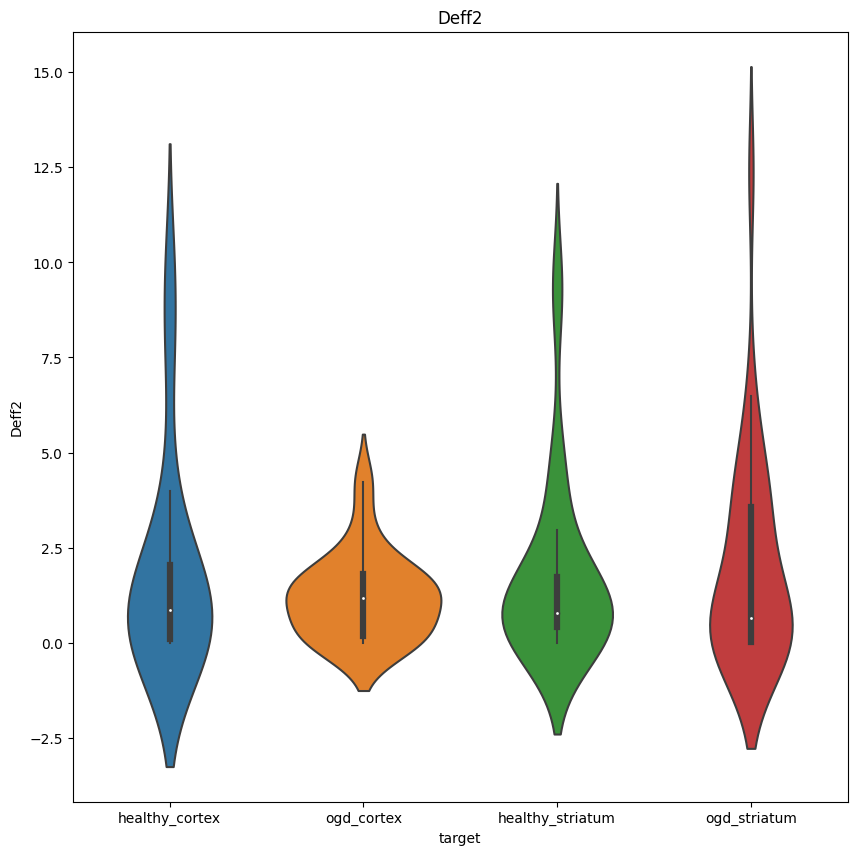

In [68]:
for feature in feature_list:
    print(feature)
    # if feature in ['Deff2', 'AR', 'MSD_ratio']:
    #     pass
    # else:
    #     feature_distribution_plots.feature_violin_plot(all_df_cleaned, feature, 'target', title=feature)
    feature_distribution_plots.feature_violin_plot(all_features_cleaned, feature, 'target', title=feature, figsize=(10, 10))

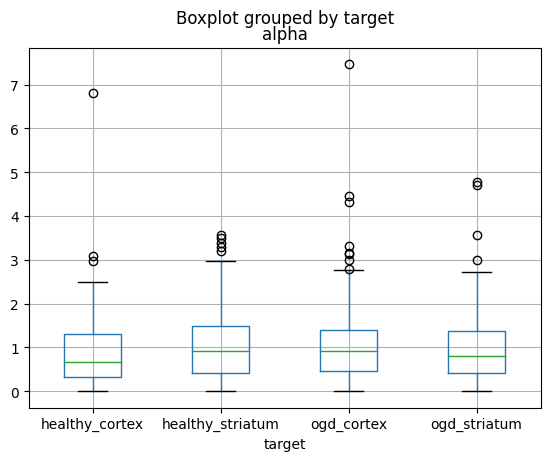

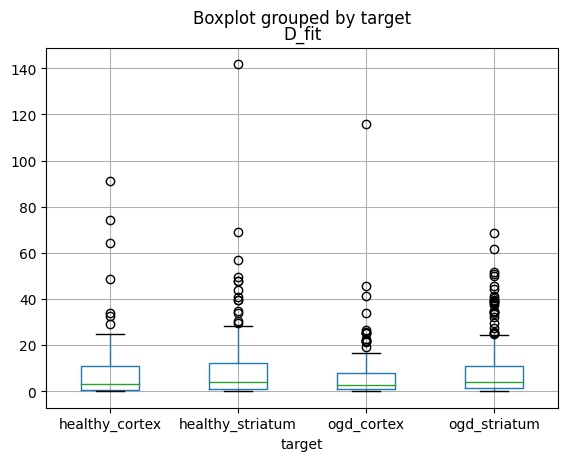

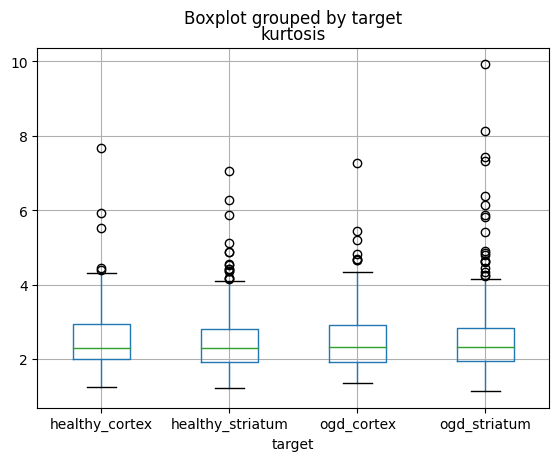

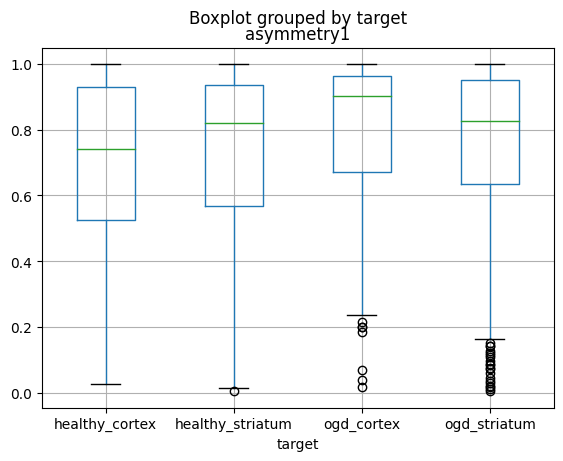

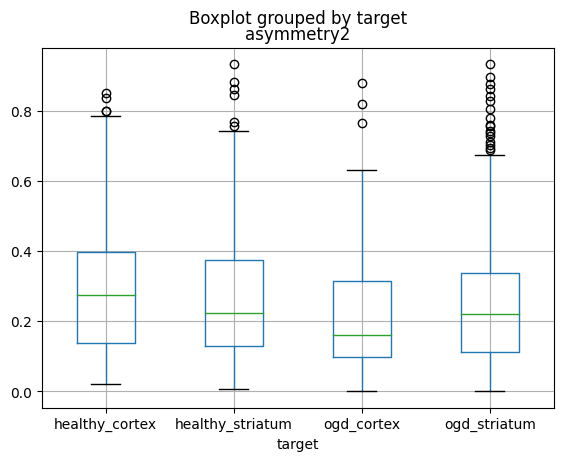

...

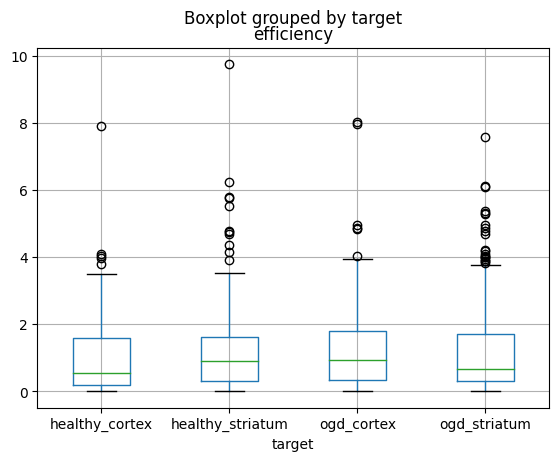

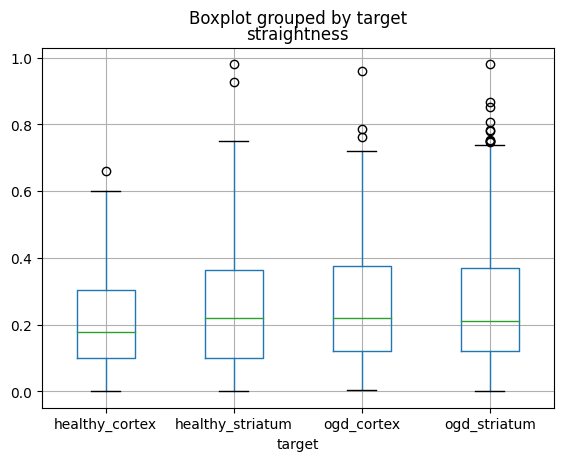

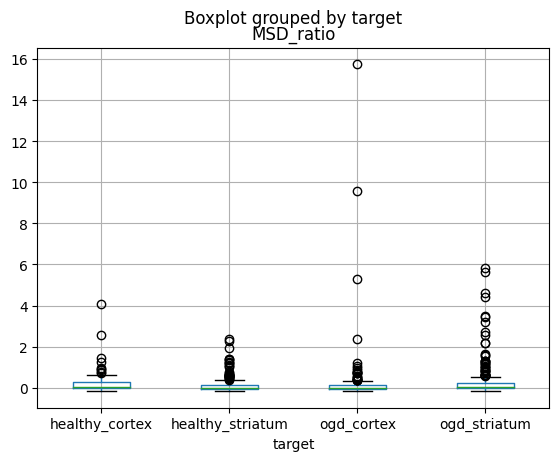

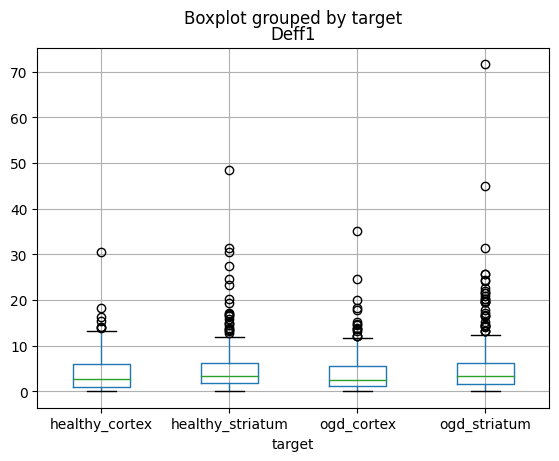

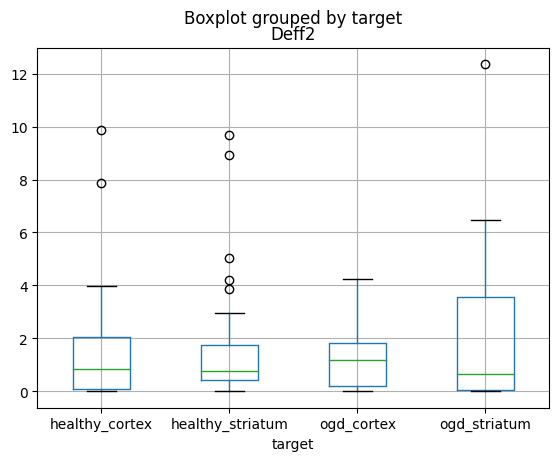

In [67]:
for feature in feature_list:
    all_features_cleaned.boxplot(feature, by='target')

In [13]:
from scipy import stats

In [16]:
ogd_striatum_deff1 = all_features_cleaned[all_features_cleaned['target'] == 'ogd_striatum']['Deff1']
print(len(ogd_striatum_deff1))
healthy_striatum_deff1 = all_features_cleaned[all_features_cleaned['target'] == 'healthy_striatum']['Deff1']
print(len(healthy_striatum_deff1))

327
232


In [40]:
res = stats.mannwhitneyu(ogd_cortex_deff1, healthy_cortex_deff1)
res

MannwhitneyuResult(statistic=9270.0, pvalue=0.6615369755416531)

In [18]:
ogd_cortex_deff1 = all_features_cleaned[all_features_cleaned['target'] == 'ogd_cortex']['Deff1']
print(len(ogd_cortex_deff1))
healthy_cortex_deff1 = all_features_cleaned[all_features_cleaned['target'] == 'healthy_cortex']['Deff1']
print(len(healthy_cortex_deff1))

168
107


In [39]:
stats.f_oneway(ogd_striatum_deff1, healthy_striatum_deff1, ogd_)

F_onewayResult(statistic=4.4909166531092464e-05, pvalue=0.9946554717537397)

In [31]:
stats.mannwhitneyu(healthy_striatum_deff1, healthy_cortex_deff1)

MannwhitneyuResult(statistic=14190.0, pvalue=0.0340515133211373)

In [32]:
stats.mannwhitneyu(ogd_cortex_deff1, ogd_striatum_deff1)

MannwhitneyuResult(statistic=24868.0, pvalue=0.08451173274054886)

In [59]:
# for file in features_healthy_cortex:
#     file = phuong_data_path + '/Healthy_QD-BEV/cortex/' + file
#     df = pd.read_csv(file)
#     fig = plot_scatterplot(df, 'Deff1', resolution=256, vmin=0, vmax=2, figsize=(4, 4))

In [57]:
# for file in features_healthy_striatum:
#     file = phuong_data_path + '/Healthy_QD-BEV/striatum/' + file
#     df = pd.read_csv(file)
#     fig = plot_scatterplot(df, 'Deff1', resolution=256, vmin=0, vmax=2)

In [58]:
# for file in features_ogd_cortex:
#     file_path = phuong_data_path + '/OGD_QD-BEV/cortex/' + file
#     df = pd.read_csv(file_path)
#     fig = plot_scatterplot(df, 'Deff1', resolution=128, vmin=0, vmax=2)
#     plt.title(file)

In [ ]:
for file in msd_ogd_cortex:
    file_path = phuong_data_path + '/OGD_QD-BEV/cortex/' + file
    df = pd.read_csv(file_path)
    fig = plot_trajectories(df, resolution=256, figsize=(4, 4), subset=False)
    plt.title('OGD Cortex: '+ file[:-4])

In [7]:
import altair as alt
import pandas as pd
import numpy as np

def plot_trajectories_altair(msd_df, resolution=512, rows=4, cols=4, subset=False, size=1000):
    """
    Plot trajectories using Altair.

    Parameters
    ----------
    msd_df : DataFrame
        DataFrame containing the trajectories to be plotted.
    resolution : int
        Resolution of base image. Only needed to calculate bounds of image.
    rows : int
        Rows of base images used to build tiled image.
    cols : int
        Columns of base images used to build tiled images.
    subset : bool
        If True, a subset of 'size' trajectories will be randomly selected and plotted.
    size : int
        Number of trajectories to plot if subset is True.
    """
    # Determine the number of particles and select a subset if requested
    particles = msd_df['Track_ID'].nunique()
    if subset:
        selected_particles = np.random.choice(msd_df['Track_ID'].unique(), size=min(size, particles), replace=False)
        msd_df = msd_df[msd_df['Track_ID'].isin(selected_particles)]
    
    # Create the Altair chart
    chart = alt.Chart(msd_df).mark_line(opacity=0.7, color='black').encode(
        x=alt.X('X:Q', scale=alt.Scale(domain=(0, resolution*cols))),
        y=alt.Y('Y:Q', scale=alt.Scale(domain=(0, resolution*rows))),
        detail='Track_ID:N'  # This ensures each track is plotted as a separate line
    ).properties(
        width=resolution*cols,
        height=resolution*rows
    ).configure_view(
        strokeWidth=0  # Removes the border around the chart
    )

    return chart


In [ ]:
alt.data_transformers.disable_max_rows()
plot_trajectories_altair(pd.read_csv(phuong_data_path + '/OGD_QD-BEV/cortex/' + msd_ogd_cortex[6]), resolution=256, rows=4, cols=4, subset=True, size=100)

In [11]:
import altair as alt
import pandas as pd
import numpy as np

def plot_trajectories_altair_interactive(msd_df, resolution=512, rows=4, cols=4, subset=False, size=1000, color_by='Track_ID'):
    """
    Plot interactive trajectories using Altair.

    Parameters
    ----------
    msd_df : DataFrame
        DataFrame containing the trajectories to be plotted.
    resolution : int
        Resolution of base image. Only needed to calculate bounds of image.
    rows : int
        Rows of base images used to build tiled image.
    cols : int
        Columns of base images used to build tiled images.
    subset : bool
        If True, a subset of 'size' trajectories will be randomly selected and plotted.
    size : int
        Number of trajectories to plot if subset is True.
    """
    # Determine the number of particles and select a subset if requested

    color_scale = alt.Scale(scheme='category10')  # You can customize the color scheme
    color_encoding = alt.Color(f'{color_by}:N', scale=color_scale, legend=None)  # Set legend=None to hide legend
    particles = msd_df['Track_ID'].nunique()
    if subset:
        selected_particles = np.random.choice(msd_df['Track_ID'].unique(), size=min(size, particles), replace=False)
        msd_df = msd_df[msd_df['Track_ID'].isin(selected_particles)]
    
    # Create the Altair chart
    chart = alt.Chart(msd_df).mark_line(opacity=0.7, color='black').encode(
        x=alt.X('X:Q', scale=alt.Scale(domain=(0, resolution*cols))),
        y=alt.Y('Y:Q', scale=alt.Scale(domain=(0, resolution*rows))),
        detail='Track_ID:N',  # This ensures each track is plotted as a separate line
        color=color_encoding
    ).properties(
        width=resolution*cols,
        height=resolution*rows
    ).configure_view(
        strokeWidth=0  # Removes the border around the chart
    ).interactive()  # Enables zoom and pan interactivity

    return chart


In [136]:
alt.data_transformers.disable_max_rows()
chart = plot_trajectories_altair_interactive(pd.read_csv(phuong_data_path + '/OGD_QD-BEV/cortex/' + msd_ogd_cortex[0]), resolution=256, rows=4, cols=4, subset=False, size=1000)

In [ ]:
chart.display()

In [28]:
import pandas as pd
import numpy as np
import altair as alt

def sample_trajectories(msd_df, N=5, plot=False, resolution=512, rows=4, cols=4):
    """
    Return and optionally plot N randomly sampled trajectories.

    Parameters
    ----------
    msd_df : DataFrame
        DataFrame containing the trajectories to be sampled and plotted.
    N : int
        Number of trajectories to sample.
    plot : bool
        If True, plots the sampled trajectories.
    resolution : int
        Resolution of base image, used for plotting.
    rows : int
        Number of rows in the tiled image setup, used for plotting.
    cols : int
        Number of columns in the tiled image setup, used for plotting.

    Returns
    -------
    sampled_trajectories : DataFrame
        A DataFrame containing the sampled trajectories.
    charts : list of alt.Chart (optional)
        A list of Altair Chart objects if plotting is requested.
    """
    # Sample N unique track IDs without replacement

    # Setup color encoding based on the provided column
    color_scale = alt.Scale(scheme='category10')  # You can customize the color scheme
    color_encoding = alt.Color(f'{color_by}:N', scale=color_scale, legend=None)  # Set legend=None to hide legend
    
    unique_tracks = msd_df['Track_ID'].unique()
    sampled_track_ids = np.random.choice(unique_tracks, size=min(N, len(unique_tracks)), replace=False)
    
    # Filter the DataFrame to include only the sampled track IDs
    sampled_trajectories = msd_df[msd_df['Track_ID'].isin(sampled_track_ids)]
    
    if plot:
        charts = []
        for track_id in sampled_track_ids:
            track_df = sampled_trajectories[sampled_trajectories['Track_ID'] == track_id]
            chart = alt.Chart(track_df).mark_line(opacity=0.7, color='black').encode(
                x=alt.X('X:Q', scale=alt.Scale(domain=(0, resolution*cols))),
                y=alt.Y('Y:Q', scale=alt.Scale(domain=(0, resolution*rows))),
            ).properties(
                title=f'Track ID: {track_id}',
                width=400,
                height=400
            ).interactive()
            charts.append(chart)
        return sampled_trajectories, charts

    return sampled_trajectories


In [30]:
def get_traj_list(df):   

    output_df = pd.DataFrame()

    trackids = df.Track_ID.unique()
    partcount = trackids.shape[0]

    for particle in range(0, partcount):
        single_track_masked =\
            df.loc[df['Track_ID'] ==
                    trackids[particle]].sort_values(['Track_ID', 'Frame'],
                                                    ascending=[
                                                    1,
                                                    1]).reset_index(drop=True)
        #single_track = unmask_track(single_track_masked)
        single_track = single_track_masked
        # alph, coef = alpha_calc(single_track)
        # if (len(single_track) > 66) & (alph > 0):
        #     rc_short = (single_track['MSDs'][33] / 4 * 33) / (single_track['MSDs'][7] / 4*7)
        #     rc_long = (single_track['MSDs'][66] / 4 * 66) / (single_track['MSDs'][33] / 4*33)
        #     new_dict = {
        #         'X': single_track['X'],
        #         'Y': single_track['Y'],
        #         'alpha': alph,
        #         'rc_short': rc_short,
        #         'rc_long': rc_long
        #    }
        if output_df.empty:
            output_df = single_track
        else:
            output_df = pd.concat([output_df, single_track])
    return output_df

In [19]:
test_df = pd.read_csv(phuong_data_path + '/OGD_QD-BEV/cortex/' + msd_ogd_cortex[6])
test_df['Track_ID'].nunique()

228

In [21]:
output = get_traj_list(pd.read_csv(phuong_data_path + '/OGD_QD-BEV/cortex/' + msd_ogd_cortex[0]))
output['Track_ID'].nunique()

449

In [9]:
def plot_all_particles_altair(df, color_by='Track_ID'):

    brush = alt.selection_interval()
    # Setup color encoding based on the provided column
    color_scale = alt.Scale(scheme='category10')  # You can customize the color scheme
    color_encoding = alt.Color(f'{color_by}:N', scale=color_scale, legend=None)  # Set legend=None to hide legend
       # Create the Altair chart
    trajectories = alt.Chart(df).mark_line(opacity=0.7).encode(
        x=alt.X('X:Q'),# scale=alt.Scale(domain=(0, resolution*cols))),
        y=alt.Y('Y:Q'),# scale=alt.Scale(domain=(0, resolution*rows))),
        color=color_encoding,
        detail='Track_ID:N',  # This ensures each track is plotted as a separate line
        order='Frame:N',
    # ).properties(
    #     width=resolution*cols,
    #     height=resolution*rows
    # ).configure_view(
    #     strokeWidth=0  # Removes the border around the chart
    ).add_selection(
        brush
    )  # Enables zoom and pan interactivity

    # Text mark to show unique Track IDs based on the selection
    unique_track_ids = alt.Chart(df).mark_text(align='left', dx=5, dy=-5).encode(
        x=alt.value(5),  # Position the text to the right of the selection
        y=alt.value(5),  # Position the text to the top of the selection
        text=alt.Text('Track_ID:N', aggregate='distinct'),
        opacity=alt.condition(brush, alt.value(1), alt.value(0))
    ).transform_filter(
        brush
    )
    chart = trajectories + unique_track_ids

    return chart

In [7]:
import altair as alt
import pandas as pd
import numpy as np

# Assuming df is your DataFrame with 'X', 'Y', 'Track_ID', and 'Frame' columns

def plot_all_particles_altair_with_side_panel(df, color_by='Track_ID'):
    # Define an interval selection for selecting points in the plot
    brush = alt.selection_interval()

    # Setup color encoding based on the provided column
    color_scale = alt.Scale(scheme='category10')  # Customize the color scheme
    color_encoding = alt.Color(f'{color_by}:N', scale=color_scale, legend=None)  # Hide legend

    # Create the Altair chart for trajectories with interactive selection
    trajectories = alt.Chart(df).mark_line(opacity=0.7).encode(
        x='X:Q',
        y='Y:Q',
        color=color_encoding,
        detail='Track_ID:N',  # Ensures each track is plotted as a separate line
    ).add_selection(
        brush  # Adds interactive selection
    ).properties(
        width=500,
        height=300
    )

    # Creating a chart for displaying unique Track_IDs based on the selection
    # Use transform_filter to filter based on brush, and transform_window to ensure uniqueness
    unique_track_ids = alt.Chart(df).transform_filter(
        brush
    ).transform_aggregate(
        unique_ids='distinct(Track_ID)',
        groupby=['Track_ID']
    ).mark_text().encode(
        y=alt.Y('Track_ID:N', sort='ascending', axis=alt.Axis(title="Selected Track IDs")),
        text='Track_ID:N',
    ).properties(
        width=150,  # Adjust width as needed
        height=300  # Match height to the trajectories chart
    )

    # Combine the trajectories chart with the unique Track_IDs text chart
    chart = alt.hconcat(trajectories, unique_track_ids, spacing=30)  # Adjust spacing as needed

    return chart


In [35]:
for i, file in enumerate(msd_ogd_striatum):
    df = pd.read_csv(phuong_data_path + '/OGD_QD-BEV/striatum/' + file)
    
    print(f'file {i} is {file}')
    print(df['Track_ID'].nunique())

file 0 is msd_100X_OGD_QD-BEV_Striatum_Slice1_Video2.csv
149
file 1 is msd_100X_OGD_QD-BEV_Striatum_Slice1_Video1.csv
110
file 2 is msd_100X_Striatum_Video1_TRITC.csv
38
file 3 is msd_100X_OGD_Striatum_Slice2_Video4.csv
26
file 4 is msd_100X_OGD_Striatum_Slice2_Video1.csv
59
file 5 is msd_100X_OGD_Striatum_Slice2_Video3.csv
16
file 6 is msd_100X_OGD_Striatum_Slice1_Video1.csv
36
file 7 is msd_100X_Striatum_OGD_QD-BEV_Slice1_Video4.csv
139
file 8 is msd_100X_OGD_Striatum_Slice1_Video2.csv
53
file 9 is msd_100X_OGD_Striatum_Slice1_Video3.csv
76
file 10 is msd_100X_Striatum_OGD_QD-BEV_Slice1_Video2.csv
40
file 11 is msd_100X_Striatum_OGD_QD-BEV_Slice1_Video3.csv
151
file 12 is msd_100X_OGD_Striatum_Slice1_Video4.csv
59
file 13 is msd_100X_OGD_Striatum_Slice1_Video5.csv
52
file 14 is msd_100X_OGD_QD-BEV_Striatum_Slice2_Video2.csv
268
file 15 is msd_100X_OGD_Striatum_Slice3_Video1.csv
22
file 16 is msd_100X_OGD_QD-BEV_Striatum_Slice2_Video3.csv
572
file 17 is msd_100X_OGD_QD-BEV_Striatum_Sl

In [32]:
output = get_traj_list(pd.read_csv(phuong_data_path + '/Healthy_QD-BEV/cortex/' + msd_healthy_cortex[1]))
output['Track_ID'].nunique()

69

In [22]:
alt.data_transformers.disable_max_rows()
plot_all_particles_altair_with_side_panel(output)

alt.HConcatChart(...)

In [ ]:
output[output['Track_ID'] == 22]

In [123]:
alt.data_transformers.disable_max_rows()
plot_all_particles_altair(output)

alt.LayerChart(...)

In [33]:
def plot_all_particles(df, start_frame = 0, end_frame = 651, color_by='Track_ID'):
    fig = plt.figure()
    for track_id in df['Track_ID'].unique():
        plt.plot(df[df['Track_ID'] == track_id]['X'][start_frame:end_frame], df[df['Track_ID'] == track_id]['Y'][start_frame:end_frame])
    return fig

In [ ]:
for i in range(len(msd_ogd_cortex)):
    fig = plot_all_particles(
        get_traj_list(
            pd.read_csv(
                phuong_data_path + '/OGD_QD-BEV/cortex/' + msd_ogd_cortex[i])),
                start_frame=0, end_frame=651)
    plt.title('OGD cortex: '+ msd_ogd_cortex[i][:-4])

In [34]:
def basic_traj_plot(traj):   
    fig = plt.plot(traj['X'], traj['Y'])
    xmin = traj['X'].min()
    xmax = traj['X'].max()
    ymin = traj['Y'].min()
    ymax = traj['Y'].max()

    # xrange = [(xmax+xmin)/2 - 17.5,(xmax+xmin)/2 + 17.5]
    # yrange = [(ymax+ymin)/2 - 17.5,(ymax+ymin)/2 + 17.5]

    xrange = [(xmax+xmin)/2 - 50,(xmax+xmin)/2 + 50]
    yrange = [(ymax+ymin)/2 - 50,(ymax+ymin)/2 + 50]

   
    plt.xlim(xrange)
    plt.ylim(yrange)
    return fig

In [13]:
def segment_trajectory(traj, seg_length):
    
    segments = []
    #remainder = len(traj) % seg_length
    for i in range(0, len(traj), seg_length):
        segment = traj[i:i+seg_length+1]
        if len(segment) == seg_length+1:
            segments.append(segment)
        else:
            segments.append(traj[i:])

    return segments

In [54]:
def plot_segmented_trajectory(traj, seg_length):
    """
    segments a trajectory and then plots each trajectory segment as a different color, from blue to red
    """

    xmin = traj['X'].min()
    xmax = traj['X'].max()
    ymin = traj['Y'].min()
    ymax = traj['Y'].max()

    # xrange = [(xmax+xmin)/2 - 17.5,(xmax+xmin)/2 + 17.5]
    # yrange = [(ymax+ymin)/2 - 17.5,(ymax+ymin)/2 + 17.5]

    xrange = [(xmax+xmin)/2 - 50,(xmax+xmin)/2 + 50]
    yrange = [(ymax+ymin)/2 - 50,(ymax+ymin)/2 + 50]

    segments = segment_trajectory(traj, seg_length)
    fig = plt.figure()
    for i, segment in enumerate(segments):
        plt.plot(segment['X'], segment['Y'], color=(1-i/len(segments), 0, i/len(segments)), label=f'Segment {i+1}')

    plt.xlim(xrange)
    plt.ylim(yrange)
    #plt.legend()
    return fig

In [90]:
test_traj = output[output['Track_ID'] == 35]
test_traj = test_traj[test_traj['X']>0]
test_traj

,Unnamed: 0,Frame,Track_ID,X,Y,MSDs,Gauss,Quality,SN_Ratio,Mean_Intensity
54,54,54.0,35.0,360.462,154.635,NaN,NaN,0.738,0.195,134.774
55,55,55.0,35.0,363.441,155.354,NaN,NaN,0.608,0.318,135.262
56,56,56.0,35.0,362.124,151.596,NaN,NaN,0.681,0.293,134.896
57,57,57.0,35.0,357.689,145.387,NaN,NaN,0.687,0.212,133.896
58,58,58.0,35.0,358.245,149.160,NaN,NaN,0.699,0.305,134.837


In [91]:
seg_list = segment_trajectory(test_traj, 10)
len(seg_list)

1

/var/folders/x0/30gk1h9n3fqfnt97pwz4bw380000gn/T/ipykernel_21259/3271921167.py:2: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


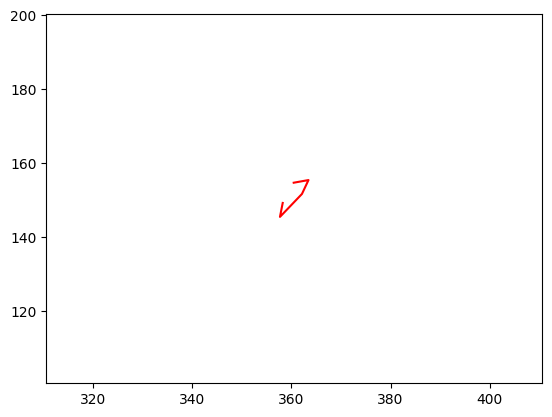

In [92]:
fig = plot_segmented_trajectory(test_traj, 10)
fig.show()

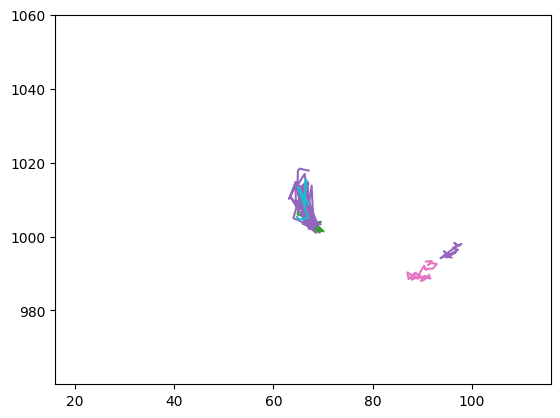

In [58]:
def basic_traj_plot_altair(traj):
    # Calculate xmin, xmax, ymin, ymax
    xmin = traj['X'].min()
    xmax = traj['X'].max()
    ymin = traj['Y'].min()
    ymax = traj['Y'].max()

    # Define xrange and yrange
    xrange = [(xmax + xmin) / 2 - 50, (xmax + xmin) / 2 + 50]
    yrange = [(ymax + ymin) / 2 - 50, (ymax + ymin) / 2 + 50]

    # Create Altair chart
    chart = alt.Chart(traj).mark_line().encode(
        x=alt.X('X:Q', scale=alt.Scale(domain=xrange)),
        y=alt.Y('Y:Q', scale=alt.Scale(domain=yrange)),
        order='Frame:N'
    ).properties(
        width=500,  # You can adjust the width as needed
        height=500   # You can adjust the height as needed
    )

    return chart


In [59]:
basic_traj_plot_altair(output[output['Track_ID'] == 2])

alt.Chart(...)